# Segmentación Semántica de Gliomas Cerebrales en Imágenes de Resonancia Magnética (MRI) utilizando Arquitecturas U-Net con Transfer Learning y Explicabilidad

Integrante: Christian Kefrey Fonseca Rodriguez

Grupo 9

In [1]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib  # Para leer archivos de formato NIfTI
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp # Biblioteca de alto nivel para modelos de segmentación
from tqdm import tqdm # Para barras de progreso
from sklearn.model_selection import train_test_split
import cv2 # OpenCV para manipulación de imágenes como redimensionamiento y superposición

# Importación de SciPy para métricas avanzadas (Distancia de Hausdorff)
from scipy.spatial.distance import cdist

# Importaciones para XAI (Grad-CAM)
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import SemanticSegmentationTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

c:\Users\chris\anaconda3\envs\vision\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Configuración del dispositivo (GPU si está disponible, de lo contrario CPU)
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Usando dispositivo: {DEVICE}")

Usando dispositivo: cuda


## DEFINICIÓN DE PARÁMETROS Y RUTAS

Parámetros globales para el entrenamiento y el procesamiento de datos.

In [4]:
# Ruta al directorio principal que contiene los datos de BraTS 2021
DATA_DIR = 'F:/Proyectos/brain_segmentation/data/BraTS2021_Training_Data/'

# Parámetros del modelo y entrenamiento
IMG_SIZE = 240 # Tamaño al que se redimensionarán las imágenes
BATCH_SIZE = 8
EPOCHS = 50
LEARNING_RATE = 1e-4
ENCODER = 'resnet50'
PRETRAINED_WEIGHTS = 'imagenet'

## CARGA DE DATOS Y PRE-PROCESAMIENTO

Funciones para encontrar, cargar y pre-procesar los datos de BraTS.

In [5]:
def get_patient_paths(data_dir):
    """
    Obtiene las rutas a las carpetas de cada paciente.
    """
    patient_folders = glob.glob(os.path.join(data_dir, 'BraTS2021_*'))
    return patient_folders

def preprocess_mask(mask):
    """
    Pre-procesa la máscara de segmentación de BraTS.ssss
    Las etiquetas originales son 1 (NCR), 2 (ED), 4 (ET).
    Se mapean a 1 (NCR), 2 (ED), 3 (ET) para facilitar el manejo en PyTorch.
    La clase 0 es el fondo.
    """
    mask_processed = np.zeros_like(mask)
    mask_processed[mask == 1] = 1  # NCR
    mask_processed[mask == 2] = 2  # ED
    mask_processed[mask == 4] = 3  # ET
    return mask_processed

def load_and_preprocess_sample(patient_path):
    """
    Carga las 4 modalidades de MRI y la máscara para un paciente,
    y las pre-procesa.
    Retorna una lista de pares (imagen_apilada, mascara_procesada) para los cortes con tumor.
    """
    processed_samples = []
    try:
        # Cargar las 4 modalidades y la máscara
        # glob.glob devuelve una lista, tomamos el primer elemento 
        flair_path = glob.glob(os.path.join(patient_path, '*_flair.nii.gz'))
        t1_path = glob.glob(os.path.join(patient_path, '*_t1.nii.gz'))
        t1ce_path = glob.glob(os.path.join(patient_path, '*_t1ce.nii.gz'))
        t2_path = glob.glob(os.path.join(patient_path, '*_t2.nii.gz'))
        seg_path = glob.glob(os.path.join(patient_path, '*_seg.nii.gz'))

        flair_img = nib.load(flair_path[0]).get_fdata()
        t1_img = nib.load(t1_path[0]).get_fdata()
        t1ce_img = nib.load(t1ce_path[0]).get_fdata()
        t2_img = nib.load(t2_path[0]).get_fdata()
        seg_mask = nib.load(seg_path[0]).get_fdata()

        # Iterar a través de los cortes axiales (última dimensión)
        for i in range(flair_img.shape[2]):
            mask_slice = seg_mask[:, :, i]
            
            # Solo procesar cortes que contienen tumor para enfocar el entrenamiento
            if np.sum(mask_slice) > 0:
                # Normalización Z-score para cada modalidad
                flair_slice = (flair_img[:, :, i] - np.mean(flair_img[:, :, i])) / (np.std(flair_img[:, :, i]) + 1e-8)
                t1_slice = (t1_img[:, :, i] - np.mean(t1_img[:, :, i])) / (np.std(t1_img[:, :, i]) + 1e-8)
                t1ce_slice = (t1ce_img[:, :, i] - np.mean(t1ce_img[:, :, i])) / (np.std(t1ce_img[:, :, i]) + 1e-8)
                t2_slice = (t2_img[:, :, i] - np.mean(t2_img[:, :, i])) / (np.std(t2_img[:, :, i]) + 1e-8)

                # Apilar las 4 modalidades para crear una imagen de 4 canales
                # La forma final debe ser (canales, altura, anchura) para PyTorch
                stacked_img = np.stack([flair_slice, t1_slice, t1ce_slice, t2_slice], axis=0)
                
                # Pre-procesar la máscara
                processed_mask = preprocess_mask(mask_slice)

                processed_samples.append((stacked_img, processed_mask))
        
        return processed_samples

    except Exception as e:
        print(f"Error procesando paciente {patient_path}: {e}")
        return processed_samples # Devolver lista vacía si hay error

## GENERADOR DE DATOS DE PYTORCH

In [6]:
class BraTSDataset(Dataset):
    def __init__(self, data):
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        # Obtener la imagen apilada y la máscara
        image, mask = self.data[idx]
        
        # Convertir a tensores de PyTorch
        # Asegurarse de que los tipos de datos son correctos
        image = torch.from_numpy(image).float()
        mask = torch.from_numpy(mask).long()
        
        return image, mask

### Métrica: Distancia de Hausdorff 95%

In [7]:
def calculate_hd95(pred_mask, gt_mask):
    """
    Calcula la Distancia de Hausdorff del 95º percentil entre dos máscaras binarias.
    Utiliza SciPy y NumPy.
    """
    pred_points = np.argwhere(pred_mask)
    gt_points = np.argwhere(gt_mask)

    # Si una máscara está vacía y la otra no, la distancia es grande.
    # Si ambas están vacías, la distancia es 0.
    if len(pred_points) == 0 and len(gt_points) == 0:
        return 0.0
    if len(pred_points) == 0 or len(gt_points) == 0:
        # Retorna una penalización grande, como la diagonal de la imagen
        return np.sqrt(pred_mask.shape[0]**2 + pred_mask.shape[1]**2)

    # Calcular las distancias de cada punto en un conjunto al punto más cercano en el otro
    distances_pred_to_gt = cdist(pred_points, gt_points).min(axis=1)
    distances_gt_to_pred = cdist(gt_points, pred_points).min(axis=1)

    # Obtener el 95º percentil de estas distancias
    hd95_pred_to_gt = np.percentile(distances_pred_to_gt, 95)
    hd95_gt_to_pred = np.percentile(distances_gt_to_pred, 95)

    # La HD95 es el máximo de las dos distancias dirigidas
    return max(hd95_pred_to_gt, hd95_gt_to_pred)

## DEFINICIÓN DE ARQUITECTURAS DE MODELOS

In [8]:
# Implementación de Attention U-Net
class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionGate, self).__init__()
        self.W_g = nn.Sequential(nn.Conv2d(F_g, F_int, 1), nn.BatchNorm2d(F_int))
        self.W_x = nn.Sequential(nn.Conv2d(F_l, F_int, 1), nn.BatchNorm2d(F_int))
        self.psi = nn.Sequential(nn.Conv2d(F_int, 1, 1), nn.BatchNorm2d(1), nn.Sigmoid())
        self.relu = nn.ReLU(inplace=True)
    def forward(self, g, x):
        g1, x1 = self.W_g(g), self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi

class ConvBlock(nn.Module):
    def __init__(self, ch_in, ch_out):
        super(ConvBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, 3, padding=1), nn.BatchNorm2d(ch_out), nn.ReLU(inplace=True),
            nn.Conv2d(ch_out, ch_out, 3, padding=1), nn.BatchNorm2d(ch_out), nn.ReLU(inplace=True)
        )
    def forward(self, x): return self.conv(x)

class AttentionUNet(nn.Module):
    def __init__(self, in_channels=4, out_channels=4):
        super(AttentionUNet, self).__init__()
        self.pool = nn.MaxPool2d(2, 2)
        self.conv1 = ConvBlock(in_channels, 64)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512)
        self.conv5 = ConvBlock(512, 1024)
        self.up5 = nn.ConvTranspose2d(1024, 512, 2, 2)
        self.att5 = AttentionGate(512, 512, 256)
        self.up_conv5 = ConvBlock(1024, 512)
        self.up4 = nn.ConvTranspose2d(512, 256, 2, 2)
        self.att4 = AttentionGate(256, 256, 128)
        self.up_conv4 = ConvBlock(512, 256)
        self.up3 = nn.ConvTranspose2d(256, 128, 2, 2)
        self.att3 = AttentionGate(128, 128, 64)
        self.up_conv3 = ConvBlock(256, 128)
        self.up2 = nn.ConvTranspose2d(128, 64, 2, 2)
        self.att2 = AttentionGate(64, 64, 32)
        self.up_conv2 = ConvBlock(128, 64)
        self.conv_out = nn.Conv2d(64, out_channels, 1)

    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.pool(x1); x2 = self.conv2(x2)
        x3 = self.pool(x2); x3 = self.conv3(x3)
        x4 = self.pool(x3); x4 = self.conv4(x4)
        x5 = self.pool(x4); x5 = self.conv5(x5)
        d5 = self.up5(x5)
        x4 = self.att5(d5, x4)
        d5 = self.up_conv5(torch.cat((x4, d5), 1))
        d4 = self.up4(d5)
        x3 = self.att4(d4, x3)
        d4 = self.up_conv4(torch.cat((x3, d4), 1))
        d3 = self.up3(d4)
        x2 = self.att3(d3, x2)
        d3 = self.up_conv3(torch.cat((x2, d3), 1))
        d2 = self.up2(d3)
        x1 = self.att2(d2, x1)
        d2 = self.up_conv2(torch.cat((x1, d2), 1))
        return self.conv_out(d2)

## ENTRENAMIENTO Y VALIDACIÓN

In [9]:
def train_epoch(model, loader, optimizer, loss_fn, device):
    model.train()
    running_loss = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = loss_fn(outputs, masks)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    return running_loss / len(loader)

def validate_epoch(model, loader, loss_fn, device):
    model.eval()
    running_loss = 0.0
    dice_score, sensitivity, hd95 = 0.0, 0.0, 0.0
    
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = loss_fn(outputs, masks)
            running_loss += loss.item()
            
            pred_masks = torch.softmax(outputs, dim=1).argmax(dim=1)
            
            # Mover a CPU y convertir a NumPy para métricas
            pred_masks_np = pred_masks.cpu().numpy()
            masks_np = masks.cpu().numpy()
            
            # Calcular métricas por lote
            batch_dice, batch_sens, batch_hd95 = [], [], []
            for i in range(images.size(0)): # Iterar sobre cada imagen en el lote
                sample_dice, sample_sens, sample_hd95 = [], [], []
                for c in range(1, 4): # Iterar sobre cada clase de tumor (1, 2, 3)
                    pred_c = (pred_masks_np[i] == c)
                    gt_c = (masks_np[i] == c)
                    
                    tp = np.sum(pred_c * gt_c)
                    fp = np.sum(pred_c * (1 - gt_c))
                    fn = np.sum((1 - pred_c) * gt_c)
                    
                    sample_dice.append((2 * tp) / (2 * tp + fp + fn + 1e-8))
                    sample_sens.append(tp / (tp + fn + 1e-8))
                    sample_hd95.append(calculate_hd95(pred_c, gt_c))
                
                batch_dice.append(np.mean(sample_dice))
                batch_sens.append(np.mean(sample_sens))
                batch_hd95.append(np.mean(sample_hd95))
            
            dice_score += np.mean(batch_dice)
            sensitivity += np.mean(batch_sens)
            hd95 += np.mean(batch_hd95)

    return (running_loss / len(loader), 
            dice_score / len(loader), 
            sensitivity / len(loader), 
            hd95 / len(loader))

## PIPELINE DE ENTRENAMIENTO COMPARATIVO

In [10]:
def run_training_pipeline(model, model_name, train_loader, val_loader, device):
    print(f"\n{'='*20} Entrenando Modelo: {model_name} {'='*20}")
    
    model.to(device)
    optimizer = torch.optim.AdamW(model.parameters(), lr=LEARNING_RATE)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3)
    loss_fn = smp.losses.DiceLoss(mode='multiclass', from_logits=True)
    
    best_val_dice = 0.0
    history = {'train_loss': [], 'val_loss': [], 'val_dice': [], 'val_sensitivity': [], 'val_hd95': []}
    
    for epoch in range(EPOCHS):
        print(f"--- Epoch {epoch+1}/{EPOCHS} ---")
        train_loss = train_epoch(model, tqdm(train_loader, desc="Entrenando"), optimizer, loss_fn, device)
        val_loss, val_dice, val_sens, val_hd = validate_epoch(model, tqdm(val_loader, desc="Validando"), loss_fn, device)
        
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['val_dice'].append(val_dice)
        history['val_sensitivity'].append(val_sens)
        history['val_hd95'].append(val_hd)
        
        print(f"Pérdida Val: {val_loss:.4f} | Dice Val: {val_dice:.4f} | Sensibilidad Val: {val_sens:.4f} | HD95 Val: {val_hd:.2f}")
        
        if val_dice > best_val_dice:
            best_val_dice = val_dice
            torch.save(model.state_dict(), f'best_model_{model_name.replace(" ", "_").replace("+", "plus").lower()}.pth')
            print(f"Mejor modelo guardado.")
            
        scheduler.step(val_loss)
        
    return history, best_val_dice

## EJECUCIÓN PRINCIPAL

In [14]:
# Cargar todas las rutas de pacientes
all_patient_paths = get_patient_paths(DATA_DIR)

# En un entrenamiento real, se usarían todos los datos.
all_patient_paths = all_patient_paths[:200] 

In [15]:
# Pre-procesar todos los datos (esto puede tardar)
print("Pre-procesando datos...")
all_samples = []
for path in tqdm(all_patient_paths, desc="Procesando Pacientes"):
    all_samples.extend(load_and_preprocess_sample(path))

print(f"Total de cortes con tumor encontrados: {len(all_samples)}")

Pre-procesando datos...


Procesando Pacientes: 100%|██████████| 200/200 [02:06<00:00,  1.58it/s]

Total de cortes con tumor encontrados: 12905


In [16]:
# Dividir los datos en entrenamiento y validación
train_data, val_data = train_test_split(all_samples, test_size=0.2, random_state=42)

train_dataset = BraTSDataset(train_data)
val_dataset = BraTSDataset(val_data)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [17]:
# Modelos a comparar
models_to_train = {
        "U-Net (ResNet50)": smp.Unet(
            encoder_name=ENCODER, 
            encoder_weights='imagenet', 
            in_channels=4, 
            classes=4),
        "Attention U-Net": AttentionUNet(
            in_channels=4, 
            out_channels=4),
        "DeepLabv3+": smp.DeepLabV3Plus(
            encoder_name=ENCODER, 
            encoder_weights=PRETRAINED_WEIGHTS, 
            in_channels=4, 
            classes=4),
        "PSPNet": smp.PSPNet(
            encoder_name=ENCODER, 
            encoder_weights=PRETRAINED_WEIGHTS, 
            in_channels=4, 
            classes=4),
        "SegFormer": smp.Unet(
            encoder_name='mit_b2', 
            encoder_weights=PRETRAINED_WEIGHTS, 
            in_channels=4, 
            classes=4) # Usando U-Net con encoder de SegFormer
    }

In [ ]:
# Corriendo el entrenamiento
results_history = {}
best_scores = {}

for name, model_instance in models_to_train.items():
    history, best_dice = run_training_pipeline(model_instance, name, train_loader, val_loader, DEVICE)
    results_history[name] = history
    best_scores[name] = best_dice


==================== Entrenando Modelo: U-Net (ResNet50) ====================
--- Epoch 1/25 ---


Validando: 100%|██████████| 165/165 [00:57<00:00,  2.85it/s]


Pérdida Val: 0.1706 | Dice Val: 0.4832 | Sensibilidad Val: 0.5082 | HD95 Val: 44.72
Mejor modelo guardado.
--- Epoch 2/25 ---


Validando: 100%|██████████| 165/165 [01:00<00:00,  2.73it/s]


Pérdida Val: 0.1201 | Dice Val: 0.5065 | Sensibilidad Val: 0.4894 | HD95 Val: 36.98
Mejor modelo guardado.
--- Epoch 3/25 ---


Validando: 100%|██████████| 165/165 [00:57<00:00,  2.87it/s]


Pérdida Val: 0.0955 | Dice Val: 0.5439 | Sensibilidad Val: 0.5392 | HD95 Val: 23.45
Mejor modelo guardado.
--- Epoch 4/25 ---


Validando: 100%|██████████| 165/165 [00:53<00:00,  3.06it/s]


Pérdida Val: 0.0888 | Dice Val: 0.5466 | Sensibilidad Val: 0.5297 | HD95 Val: 26.22
Mejor modelo guardado.
--- Epoch 5/25 ---


Validando: 100%|██████████| 165/165 [01:04<00:00,  2.55it/s]


Pérdida Val: 0.0831 | Dice Val: 0.5620 | Sensibilidad Val: 0.5644 | HD95 Val: 22.22
Mejor modelo guardado.
--- Epoch 6/25 ---


Validando: 100%|██████████| 165/165 [00:58<00:00,  2.81it/s]


Pérdida Val: 0.0768 | Dice Val: 0.5636 | Sensibilidad Val: 0.5593 | HD95 Val: 22.34
Mejor modelo guardado.
--- Epoch 7/25 ---


Validando: 100%|██████████| 165/165 [00:55<00:00,  2.96it/s]


Pérdida Val: 0.0825 | Dice Val: 0.5611 | Sensibilidad Val: 0.5539 | HD95 Val: 20.32
--- Epoch 8/25 ---


Validando: 100%|██████████| 165/165 [01:04<00:00,  2.55it/s]


Pérdida Val: 0.0724 | Dice Val: 0.5682 | Sensibilidad Val: 0.5565 | HD95 Val: 21.63
Mejor modelo guardado.
--- Epoch 9/25 ---


Validando: 100%|██████████| 165/165 [00:58<00:00,  2.83it/s]


Pérdida Val: 0.0720 | Dice Val: 0.5713 | Sensibilidad Val: 0.5672 | HD95 Val: 23.26
Mejor modelo guardado.
--- Epoch 10/25 ---


Validando: 100%|██████████| 165/165 [00:52<00:00,  3.15it/s]


Pérdida Val: 0.0667 | Dice Val: 0.5808 | Sensibilidad Val: 0.5776 | HD95 Val: 19.08
Mejor modelo guardado.
--- Epoch 11/25 ---


Validando: 100%|██████████| 165/165 [00:40<00:00,  4.04it/s]


Pérdida Val: 0.0658 | Dice Val: 0.5846 | Sensibilidad Val: 0.5852 | HD95 Val: 18.63
Mejor modelo guardado.
--- Epoch 12/25 ---


Validando: 100%|██████████| 165/165 [00:39<00:00,  4.15it/s]


Pérdida Val: 0.0706 | Dice Val: 0.5725 | Sensibilidad Val: 0.5604 | HD95 Val: 20.24
--- Epoch 13/25 ---


Validando: 100%|██████████| 165/165 [00:34<00:00,  4.84it/s]


Pérdida Val: 0.0625 | Dice Val: 0.5830 | Sensibilidad Val: 0.5758 | HD95 Val: 19.71
--- Epoch 14/25 ---


Validando: 100%|██████████| 165/165 [00:48<00:00,  3.42it/s]


Pérdida Val: 0.0655 | Dice Val: 0.5815 | Sensibilidad Val: 0.5729 | HD95 Val: 19.94
--- Epoch 15/25 ---


Validando: 100%|██████████| 165/165 [00:54<00:00,  3.05it/s]


Pérdida Val: 0.0609 | Dice Val: 0.5892 | Sensibilidad Val: 0.5823 | HD95 Val: 18.01
Mejor modelo guardado.
--- Epoch 16/25 ---


Validando: 100%|██████████| 165/165 [00:53<00:00,  3.11it/s]


Pérdida Val: 0.0647 | Dice Val: 0.5883 | Sensibilidad Val: 0.5880 | HD95 Val: 19.99
--- Epoch 17/25 ---


Validando: 100%|██████████| 165/165 [00:53<00:00,  3.11it/s]


Pérdida Val: 0.0618 | Dice Val: 0.5888 | Sensibilidad Val: 0.5822 | HD95 Val: 16.95
--- Epoch 18/25 ---


Validando: 100%|██████████| 165/165 [00:56<00:00,  2.93it/s]


Pérdida Val: 0.0619 | Dice Val: 0.5876 | Sensibilidad Val: 0.5940 | HD95 Val: 17.44
--- Epoch 19/25 ---


Validando: 100%|██████████| 165/165 [00:53<00:00,  3.08it/s]


Pérdida Val: 0.0599 | Dice Val: 0.5925 | Sensibilidad Val: 0.5922 | HD95 Val: 16.48
Mejor modelo guardado.
--- Epoch 20/25 ---


Validando: 100%|██████████| 165/165 [00:52<00:00,  3.12it/s]


Pérdida Val: 0.0576 | Dice Val: 0.5933 | Sensibilidad Val: 0.5841 | HD95 Val: 17.01
Mejor modelo guardado.
--- Epoch 21/25 ---


Validando: 100%|██████████| 165/165 [00:53<00:00,  3.08it/s]


Pérdida Val: 0.0578 | Dice Val: 0.5935 | Sensibilidad Val: 0.5931 | HD95 Val: 17.07
Mejor modelo guardado.
--- Epoch 22/25 ---


Validando: 100%|██████████| 165/165 [00:52<00:00,  3.15it/s]


Pérdida Val: 0.0555 | Dice Val: 0.5978 | Sensibilidad Val: 0.5929 | HD95 Val: 17.05
Mejor modelo guardado.
--- Epoch 23/25 ---


Validando:  42%|████▏     | 70/165 [00:24<00:24,  3.87it/s]

## ENTRENAR LOS OTROS BOOKS CON NOMBRES DE MODELOS PARA PARALELIZAR TRABAJO ANTES DE CORRER LO DE ABAJO

In [62]:
import pickle

def save_dict_pickle(d, filename):
    """Serializa y guarda el diccionario d usando pickle."""
    with open(filename, 'wb') as f:
        pickle.dump(d, f)

def load_dict_pickle(filename):
    """Carga un diccionario serializado con pickle."""
    with open(filename, 'rb') as f:
        return pickle.load(f)

r_model1 = load_dict_pickle('results_history _U-Net (ResNet50).pkl')
r_model2 = load_dict_pickle('results_history _Attention U-Net.pkl')
r_model3 = load_dict_pickle('results_history _DeepLabv3+.pkl')
r_model4 = load_dict_pickle('results_history _PSPNet.pkl')
r_model5 = load_dict_pickle('results_history _SegFormer.pkl')

In [63]:
results_models = [r_model1, r_model2, r_model3, r_model4, r_model5]

In [64]:
results_history = {}
best_scores = {}

for r_model in results_models:
    results_history[r_model['name']] = r_model['results_history']
    best_scores[r_model['name']] = r_model['best_scores']

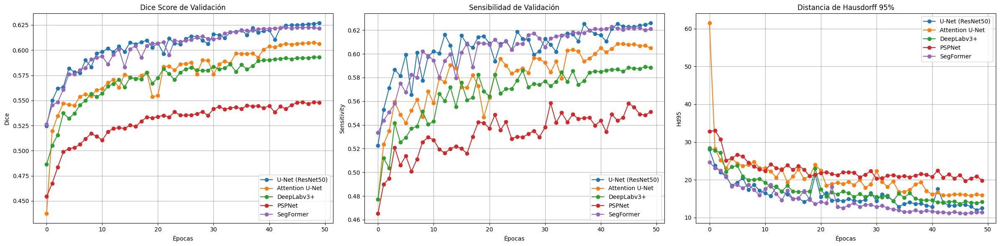

In [65]:
# Visualizar resultados comparativos
fig, axes = plt.subplots(1, 3, figsize=(24, 6))
metrics_to_plot = ['val_dice', 'val_sensitivity', 'val_hd95']
titles = ['Dice Score de Validación', 'Sensibilidad de Validación', 'Distancia de Hausdorff 95%']
for i, metric in enumerate(metrics_to_plot):
    for name, history in results_history.items():
        axes[i].plot(history[metric], label=name, marker='o')
    axes[i].set_title(titles[i])
    axes[i].set_xlabel('Épocas')
    axes[i].set_ylabel(metric.replace("val_", "").capitalize())
    axes[i].legend()
    axes[i].grid(True)
plt.tight_layout()
plt.show()

In [66]:
print("\n--- Resumen de Mejor Dice Score ---")
for name, score in best_scores.items():
    print(f"{name}: {score:.4f}")



--- Resumen de Mejor Dice Score ---
U-Net (ResNet50): 0.6270
Attention U-Net: 0.6075
DeepLabv3+: 0.5932
PSPNet: 0.5483
SegFormer: 0.6226


## VISUALIZACIÓN DE PREDICCIONES COMPARATIVAS

In [25]:
def visualize_comparative_results(models, dataset, device, num_samples=3):
    class_colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0], [0, 0, 255]], dtype=np.uint8)
    
    for i in range(num_samples):
        image, gt_mask = dataset[i]
        image_vis = image[0, :, :].numpy()
        image_tensor = image.unsqueeze(0).to(device)
        gt_mask_rgb = class_colors[gt_mask.numpy()]
        
        num_models = len(models)
        fig, axes = plt.subplots(1, 2 + num_models, figsize=(6 * (2 + num_models), 6))
        
        axes[0].imshow(image_vis, cmap='gray'); axes[0].set_title('FLAIR Original'); axes[0].axis('off')
        axes[1].imshow(gt_mask_rgb); axes[1].set_title('Máscara Real'); axes[1].axis('off')
        
        ax_idx = 2
        for name, model in models.items():
            model_path = f'best_model_{name.replace(" ", "_").replace("+", "plus").lower()}.pth'
            if os.path.exists(model_path):
                model.load_state_dict(torch.load(model_path, map_location=device))
                model.to(device) # <--- CORRECCIÓN AÑADIDA AQUÍ
                model.eval()
                with torch.no_grad():
                    pred_output = model(image_tensor)
                    pred_mask = torch.softmax(pred_output, dim=1).argmax(dim=1).squeeze().cpu().numpy()
                
                pred_mask_rgb = class_colors[pred_mask]
                axes[ax_idx].imshow(pred_mask_rgb)
                axes[ax_idx].set_title(f'Pred: {name}')
            else:
                axes[ax_idx].text(0.5, 0.5, 'Modelo no encontrado', ha='center')
            axes[ax_idx].axis('off')
            ax_idx += 1
            
        plt.tight_layout()
        plt.show()

In [23]:
def visualize_comparative_results(models, dataset, device, num_samples=3):
    class_colors = np.array([
        [  0,   0,   0],  # fondo
        [255,   0,   0],  # NCR
        [  0, 255,   0],  # ED
        [  0,   0, 255],  # ET
    ], dtype=np.uint8)
    
    for i in range(num_samples):
        image, gt_mask = dataset[i]
        image_vis = image[0, :, :].numpy()
        image_tensor = image.unsqueeze(0).to(device)
        gt_mask_rgb = class_colors[gt_mask.numpy()]
        
        num_models = len(models)
        fig, axes = plt.subplots(1, 2 + num_models, figsize=(6 * (2 + num_models), 6))
        
        axes[0].imshow(image_vis, cmap='gray'); axes[0].set_title('FLAIR Original'); axes[0].axis('off')
        axes[1].imshow(gt_mask_rgb); axes[1].set_title('Máscara Real'); axes[1].axis('off')
        
        ax_idx = 2
        for name, model in models.items():
            model_path = f'best_model_{name.replace(" ", "_").replace("+", "plus").lower()}.pth'
            if os.path.exists(model_path):
                model.load_state_dict(torch.load(model_path, map_location=device))
                model.eval()
                with torch.no_grad():
                    pred_output = model(image_tensor)
                    pred_mask = torch.softmax(pred_output, dim=1).argmax(dim=1).squeeze().cpu().numpy()
                
                pred_mask_rgb = class_colors[pred_mask]
                axes[ax_idx].imshow(pred_mask_rgb)
                axes[ax_idx].set_title(f'Pred: {name}')
            else:
                axes[ax_idx].text(0.5, 0.5, 'Modelo no encontrado', ha='center')
            axes[ax_idx].axis('off')
            ax_idx += 1
            
        plt.tight_layout()
        plt.show()


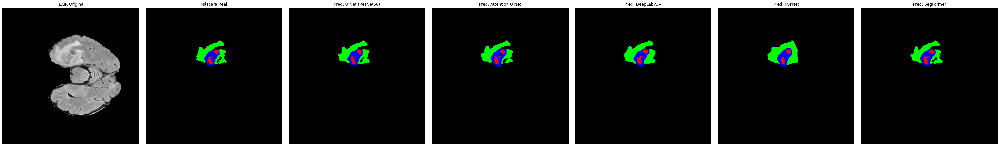

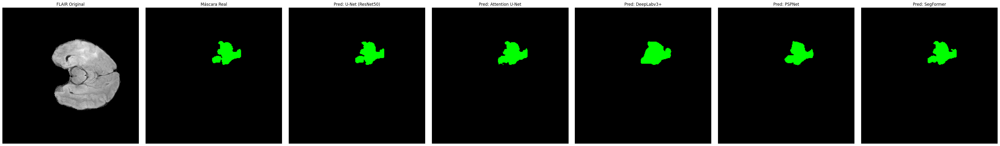

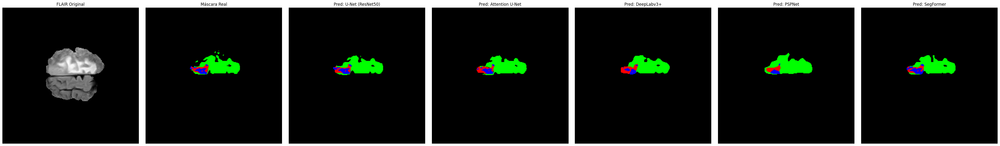

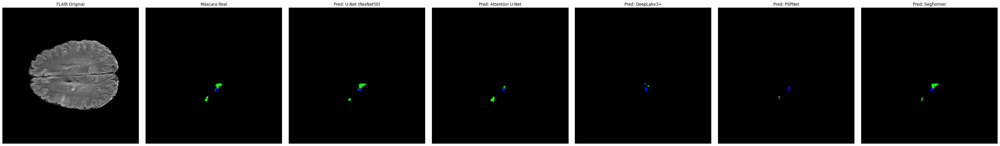

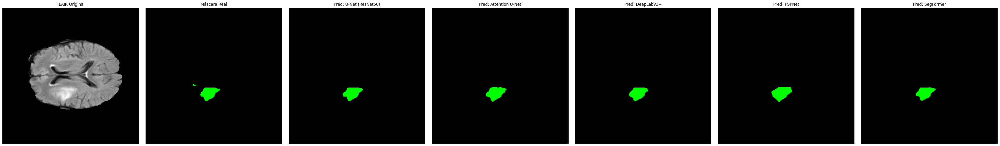

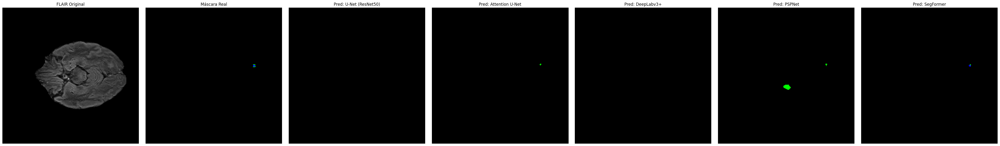

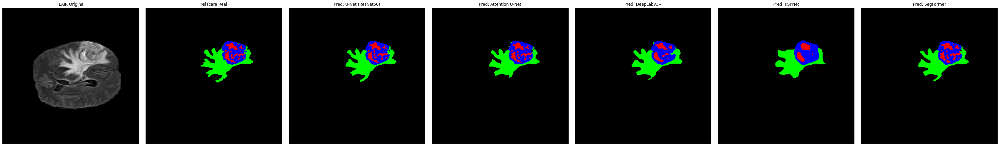

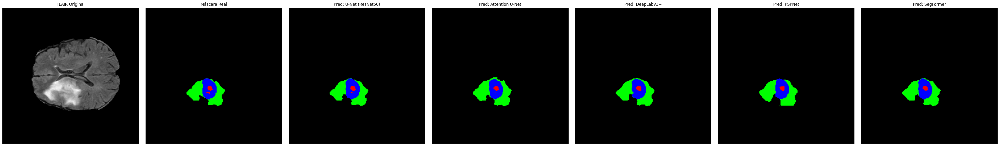

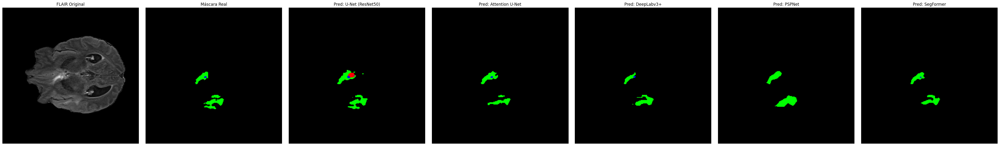

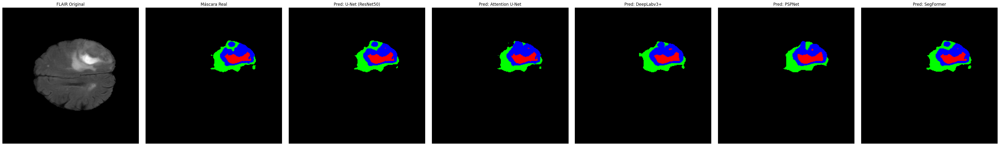

In [27]:
val_dataset_vis = BraTSDataset(val_data)
visualize_comparative_results(models_to_train, val_dataset_vis, DEVICE, num_samples=10)

In [33]:
def get_target_layers(model, model_name):
    """
    Función auxiliar para obtener las capas objetivo correctas para Grad-CAM
    dependiendo de la arquitectura del modelo.
    """
    if model_name == "Attention U-Net":
        return [model.up_conv2.conv[-1]] # Última capa convolucional del decodificador
    elif hasattr(model, 'decoder') and hasattr(model.decoder, 'blocks'):
        return [model.decoder.blocks[-1].conv2] # Para modelos de smp con decodificador estándar
    else: # Fallback genérico
        return [model.segmentation_head]

def visualize_gradcam_for_models(models, dataset, device, num_samples=1):
    """
    Genera y visualiza los mapas de calor de Grad-CAM para cada modelo y cada clase.
    """
    class_colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0], [0, 0, 255]], dtype=np.uint8)
    cam_targets = {'NCR (Clase 1)': 1, 'ED (Clase 2)': 2, 'ET (Clase 3)': 3}

    for i in range(num_samples):
        image, gt_mask = dataset[i]
        image_vis = image[0, :, :].numpy() # FLAIR para visualización
        image_tensor = image.unsqueeze(0).to(device)
        gt_mask_rgb = class_colors[gt_mask.numpy()]
        
        # Normalizar imagen para superposición de CAM y convertir a formato RGB
        image_vis_norm = (image_vis - image_vis.min()) / (image_vis.max() - image_vis.min() + 1e-8)
        image_for_cam_display = np.stack([image_vis_norm] * 3, axis=-1)

        for name, model in models.items():
            model_path = f'best_model_{name.replace(" ", "_").replace("+", "plus").lower()}.pth'
            if not os.path.exists(model_path):
                print(f"Saltando Grad-CAM para {name}, modelo no encontrado.")
                continue

            print(f"\n--- Generando Grad-CAM para: {name} ---")
            model.load_state_dict(torch.load(model_path, map_location=device))
            model.to(device)
            model.eval()

            # Obtener predicción
            with torch.no_grad():
                pred_output = model(image_tensor)
                pred_mask = torch.softmax(pred_output, dim=1).argmax(dim=1).squeeze().cpu().numpy()
            pred_mask_rgb = class_colors[pred_mask]

            # Crear figura para este modelo
            fig, axes = plt.subplots(1, 6, figsize=(30, 5))
            fig.suptitle(f'Análisis XAI para: {name}', fontsize=16)

            axes[0].imshow(image_vis, cmap='gray'); axes[0].set_title('FLAIR Original'); axes[0].axis('off')
            axes[1].imshow(gt_mask_rgb); axes[1].set_title('Máscara Real'); axes[1].axis('off')
            axes[2].imshow(pred_mask_rgb); axes[2].set_title('Predicción'); axes[2].axis('off')

            target_layers = get_target_layers(model, name)
            
            cam_ax_idx = 3
            for title, target_class in cam_targets.items():
                targets = [SemanticSegmentationTarget(target_class, pred_mask)]
                with GradCAM(model=model, target_layers=target_layers) as cam:
                    try:
                        grayscale_cam = cam(input_tensor=image_tensor, targets=targets)[0, :]
                        cam_image = show_cam_on_image(image_for_cam_display, grayscale_cam, use_rgb=True)
                        axes[cam_ax_idx].imshow(cam_image)
                    except Exception as e:
                        axes[cam_ax_idx].text(0.5, 0.5, 'Error en CAM', ha='center')
                        print(f"Error al generar Grad-CAM para {name} - {title}: {e}")

                axes[cam_ax_idx].set_title(f'Grad-CAM: {title}')
                axes[cam_ax_idx].axis('off')
                cam_ax_idx += 1
            
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()


--- Generando Grad-CAM para: U-Net (ResNet50) ---


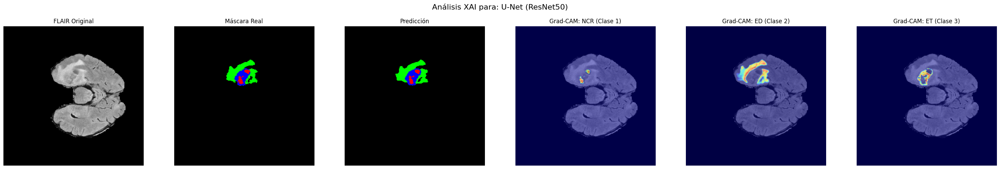


--- Generando Grad-CAM para: Attention U-Net ---


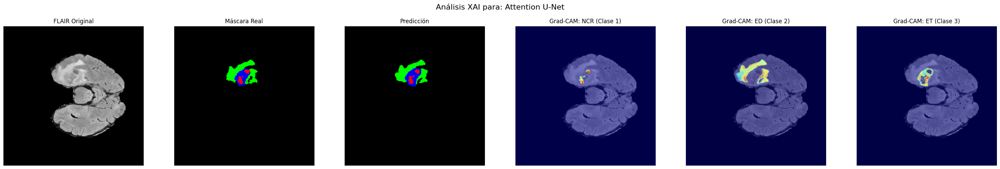


--- Generando Grad-CAM para: DeepLabv3+ ---


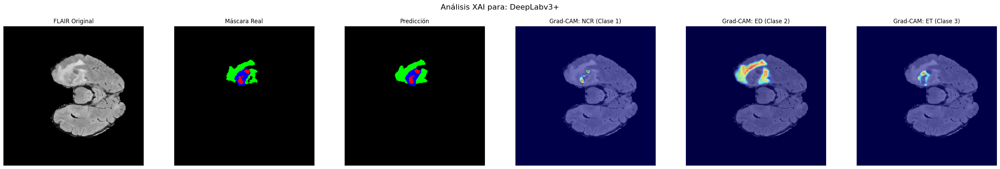


--- Generando Grad-CAM para: PSPNet ---


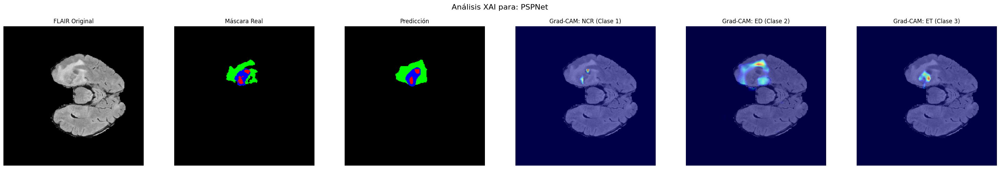


--- Generando Grad-CAM para: SegFormer ---


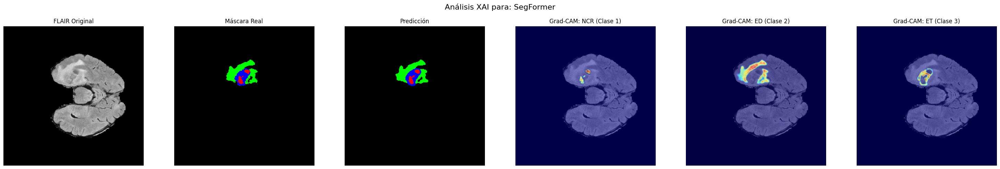


--- Generando Grad-CAM para: U-Net (ResNet50) ---


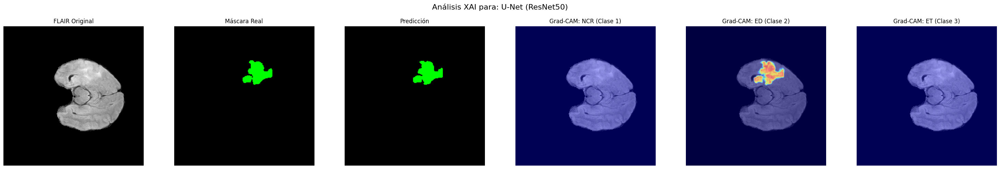


--- Generando Grad-CAM para: Attention U-Net ---


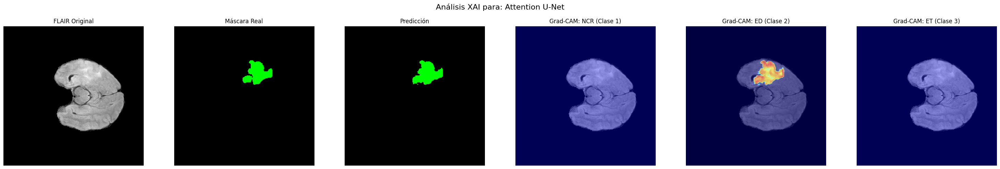


--- Generando Grad-CAM para: DeepLabv3+ ---


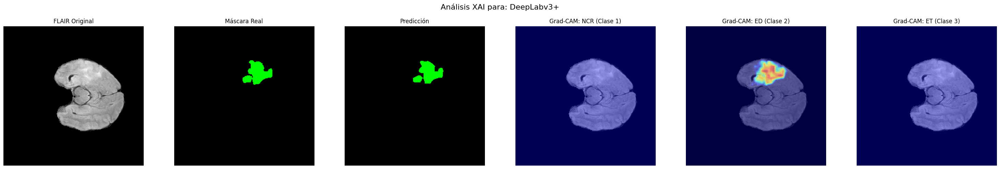


--- Generando Grad-CAM para: PSPNet ---


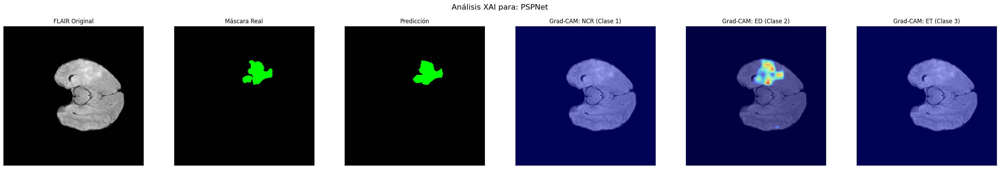


--- Generando Grad-CAM para: SegFormer ---


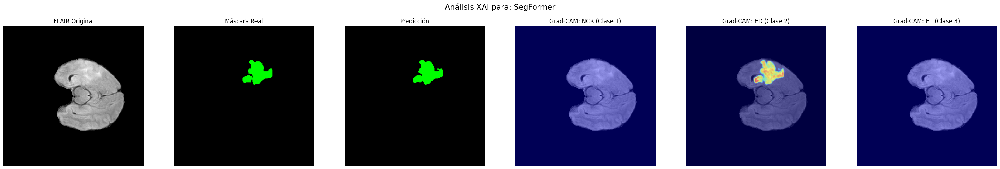


--- Generando Grad-CAM para: U-Net (ResNet50) ---


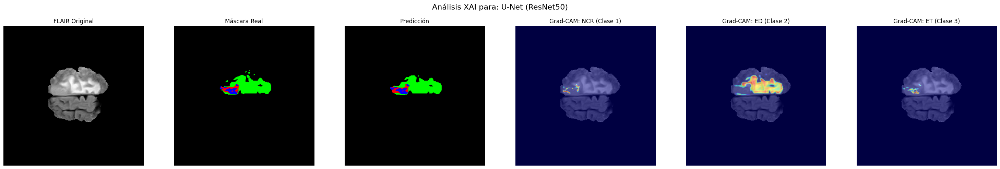


--- Generando Grad-CAM para: Attention U-Net ---


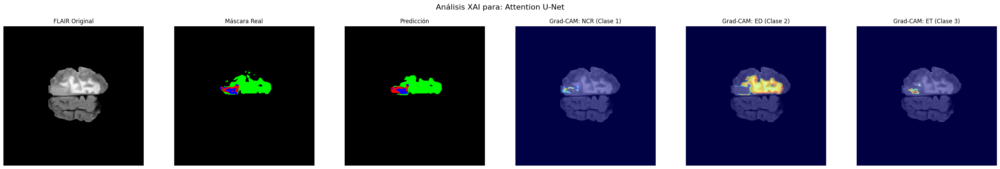


--- Generando Grad-CAM para: DeepLabv3+ ---


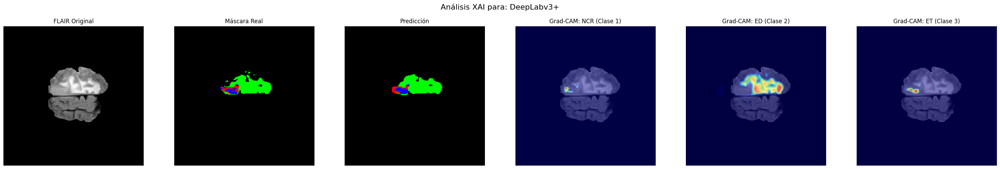


--- Generando Grad-CAM para: PSPNet ---


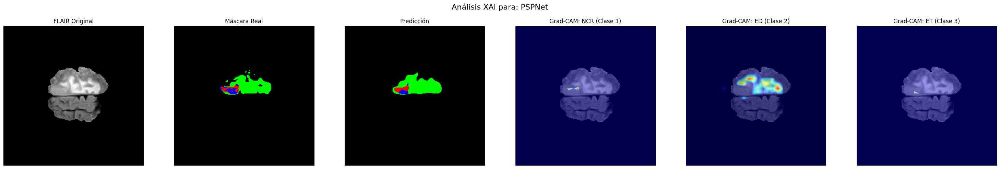


--- Generando Grad-CAM para: SegFormer ---


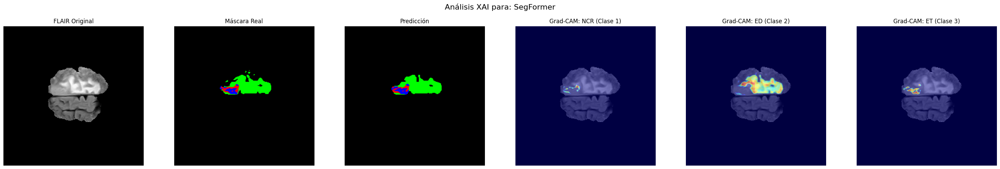


--- Generando Grad-CAM para: U-Net (ResNet50) ---


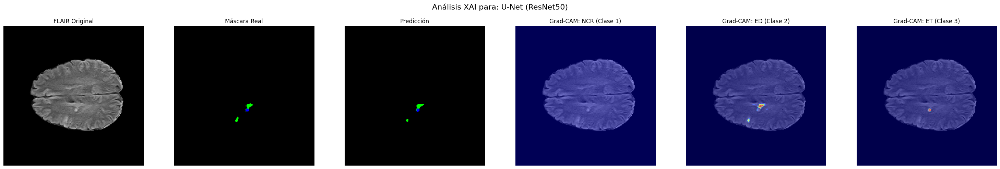


--- Generando Grad-CAM para: Attention U-Net ---


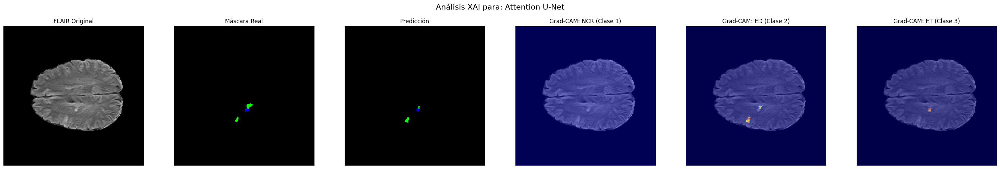


--- Generando Grad-CAM para: DeepLabv3+ ---


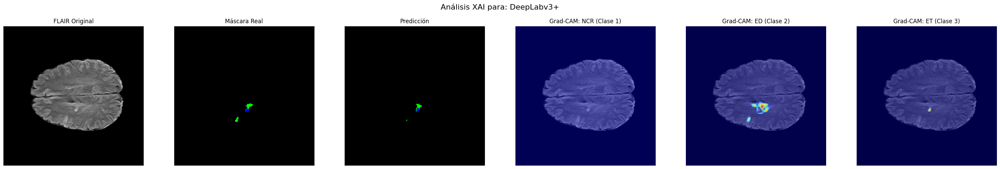


--- Generando Grad-CAM para: PSPNet ---


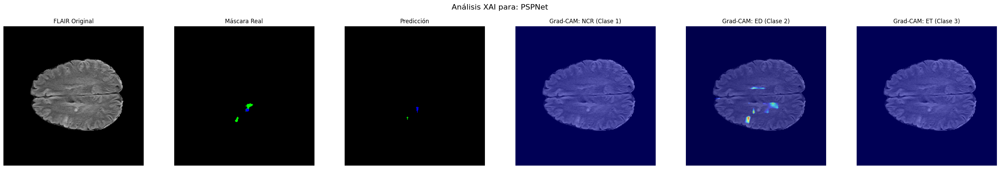


--- Generando Grad-CAM para: SegFormer ---


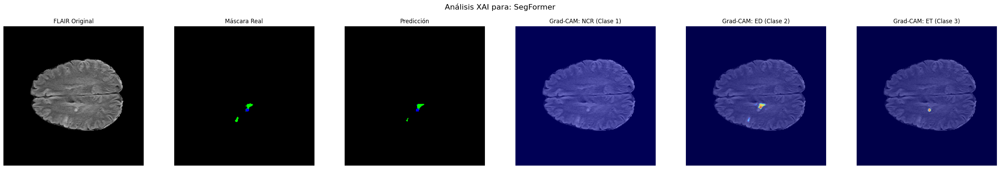


--- Generando Grad-CAM para: U-Net (ResNet50) ---


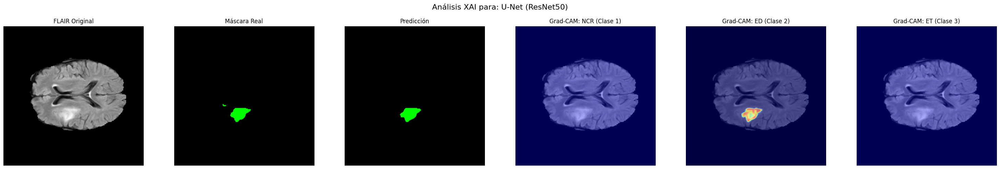


--- Generando Grad-CAM para: Attention U-Net ---


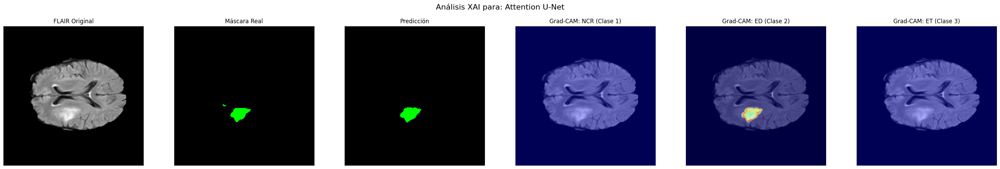


--- Generando Grad-CAM para: DeepLabv3+ ---


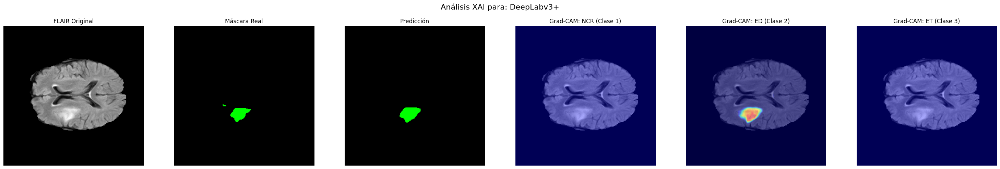


--- Generando Grad-CAM para: PSPNet ---


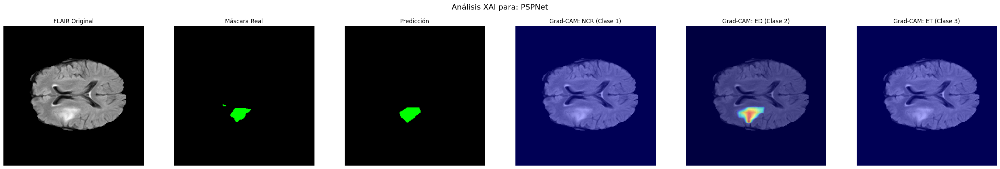


--- Generando Grad-CAM para: SegFormer ---


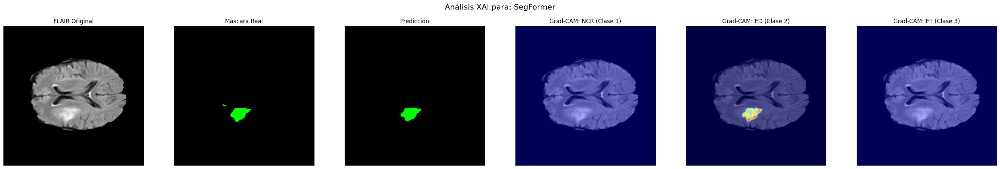


--- Generando Grad-CAM para: U-Net (ResNet50) ---


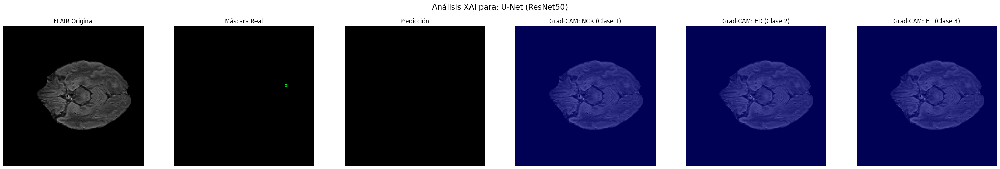


--- Generando Grad-CAM para: Attention U-Net ---


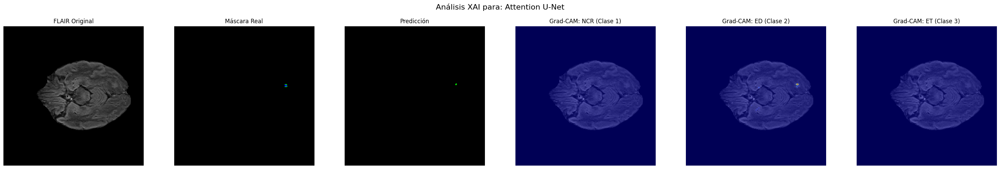


--- Generando Grad-CAM para: DeepLabv3+ ---


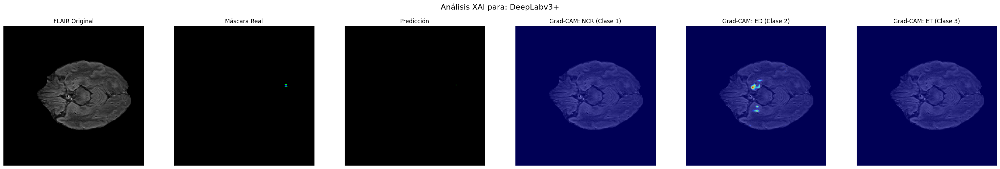


--- Generando Grad-CAM para: PSPNet ---


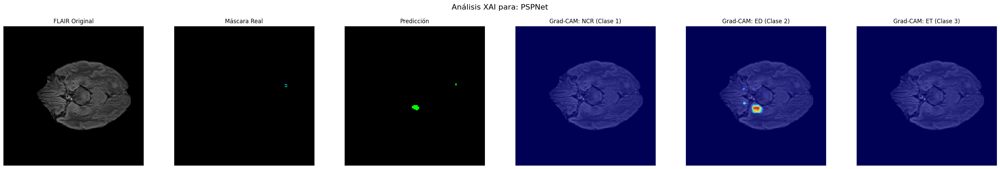


--- Generando Grad-CAM para: SegFormer ---


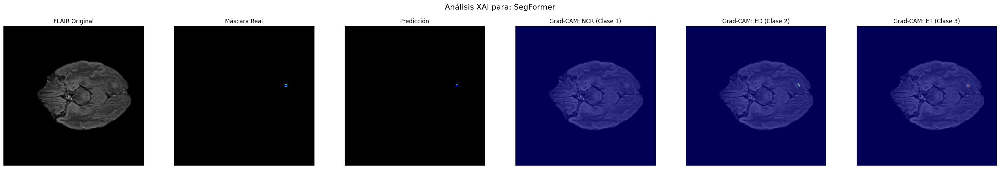


--- Generando Grad-CAM para: U-Net (ResNet50) ---


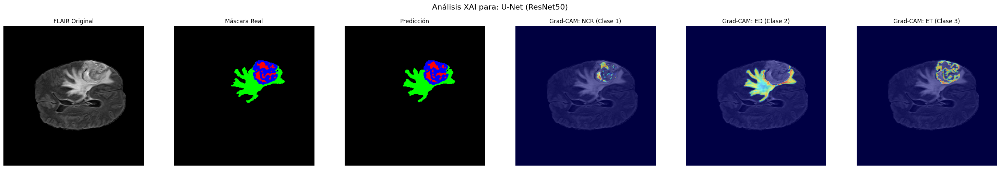


--- Generando Grad-CAM para: Attention U-Net ---


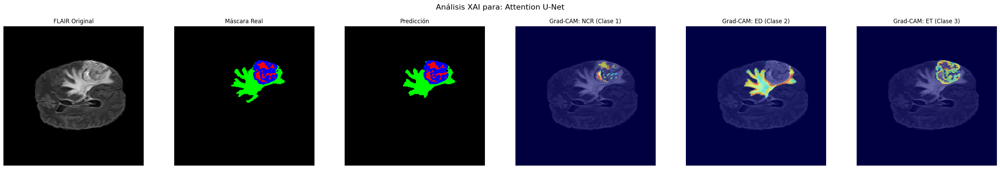


--- Generando Grad-CAM para: DeepLabv3+ ---


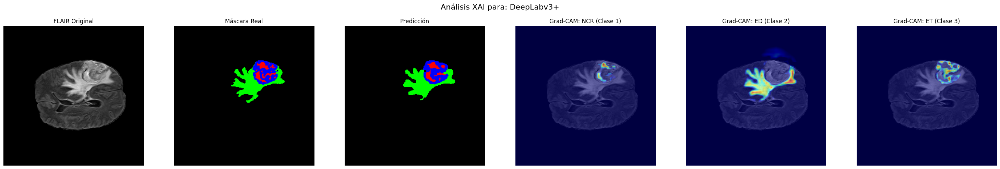


--- Generando Grad-CAM para: PSPNet ---


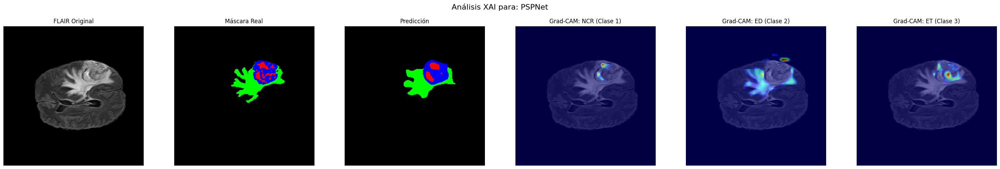


--- Generando Grad-CAM para: SegFormer ---


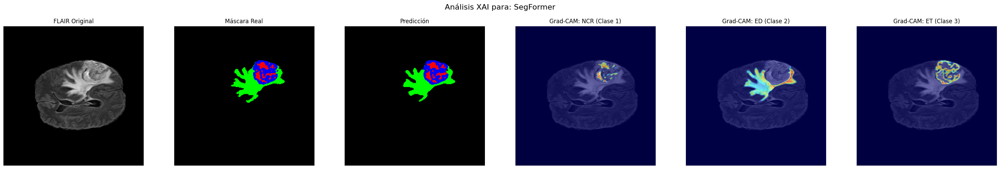


--- Generando Grad-CAM para: U-Net (ResNet50) ---


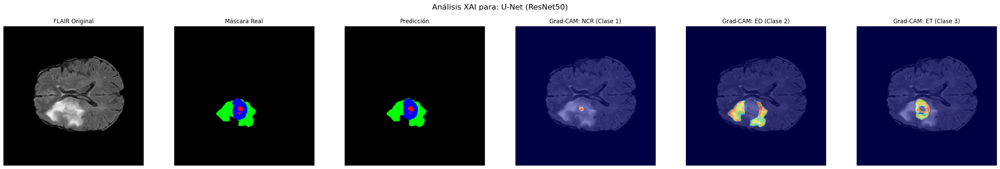


--- Generando Grad-CAM para: Attention U-Net ---


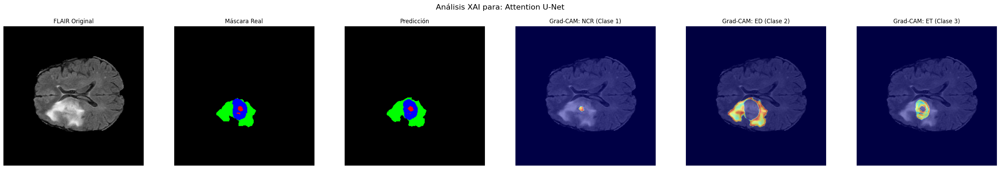


--- Generando Grad-CAM para: DeepLabv3+ ---


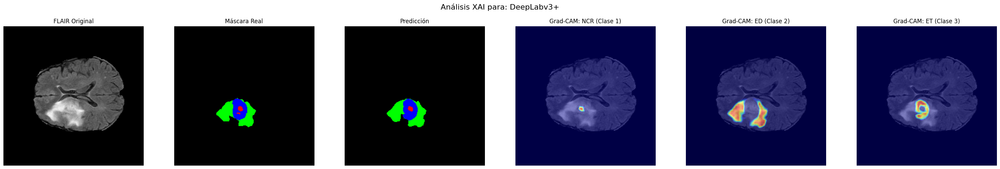


--- Generando Grad-CAM para: PSPNet ---


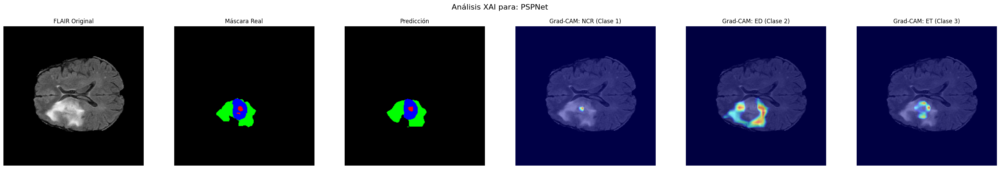


--- Generando Grad-CAM para: SegFormer ---


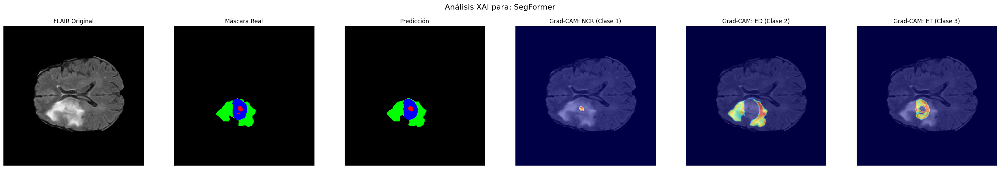


--- Generando Grad-CAM para: U-Net (ResNet50) ---


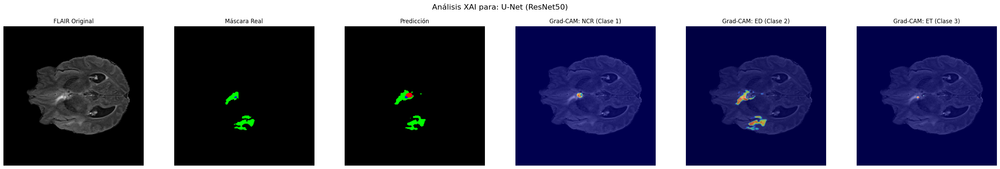


--- Generando Grad-CAM para: Attention U-Net ---


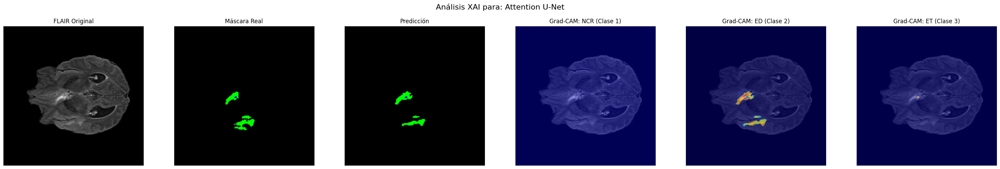


--- Generando Grad-CAM para: DeepLabv3+ ---


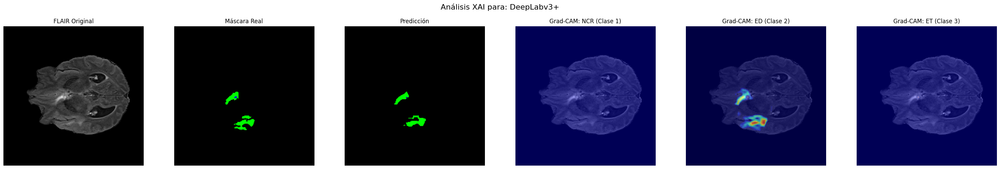


--- Generando Grad-CAM para: PSPNet ---


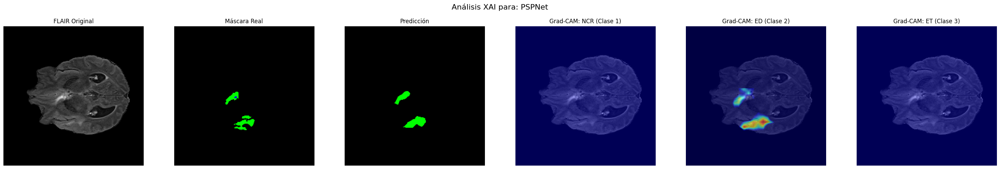


--- Generando Grad-CAM para: SegFormer ---


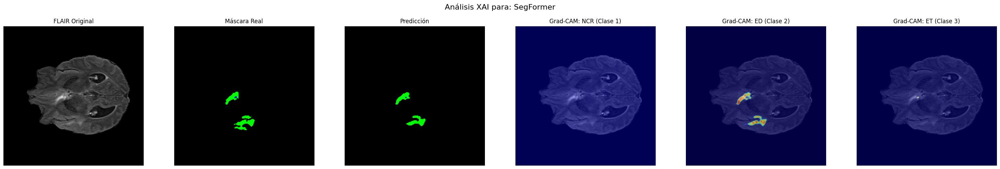


--- Generando Grad-CAM para: U-Net (ResNet50) ---


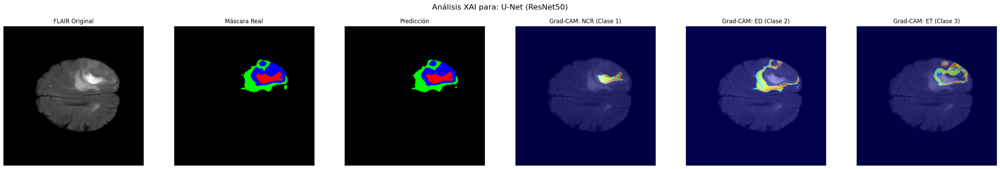


--- Generando Grad-CAM para: Attention U-Net ---


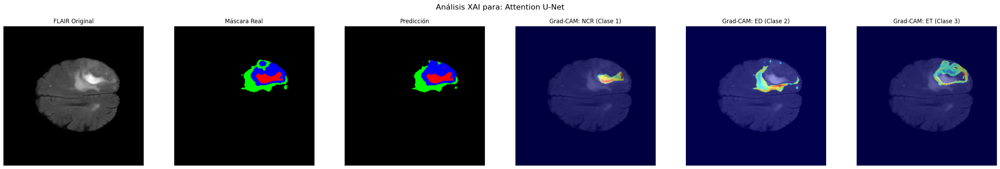


--- Generando Grad-CAM para: DeepLabv3+ ---


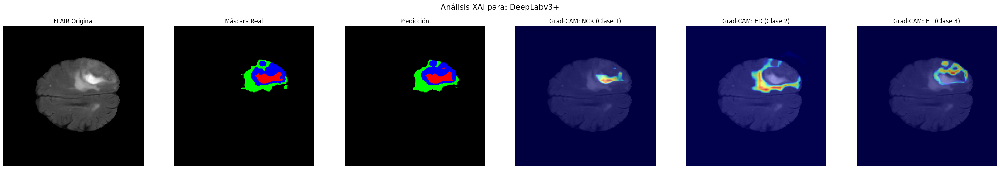


--- Generando Grad-CAM para: PSPNet ---


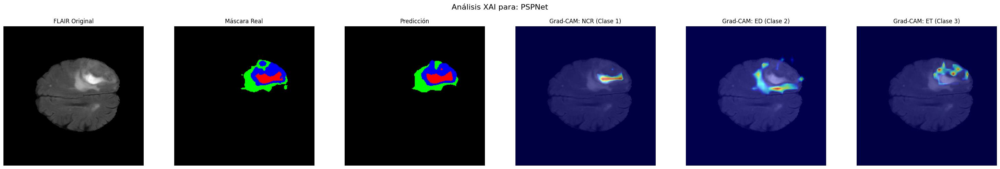


--- Generando Grad-CAM para: SegFormer ---


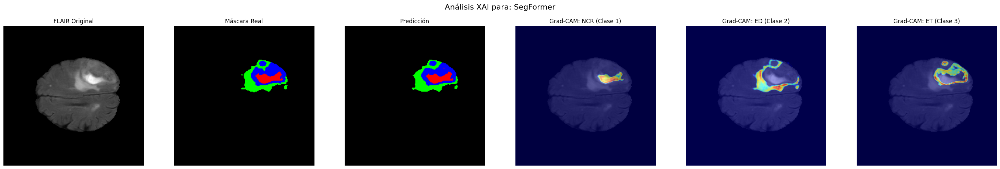

In [34]:
val_dataset_vis = BraTSDataset(val_data)
visualize_gradcam_for_models(models_to_train, val_dataset_vis, DEVICE, num_samples=10)

## PREDICCIÓN Y VISUALIZACIÓN POR PACIENTE

In [55]:
def load_and_preprocess_volume(patient_path):
    """
    Carga y pre-procesa el volumen completo de un paciente, corte por corte.
    Retorna listas de imágenes y máscaras.
    """
    all_images = []
    all_masks = []
    try:
        # Cargar las 4 modalidades y la máscara
        flair_img = nib.load(glob.glob(os.path.join(patient_path, '*_flair.nii.gz'))[0]).get_fdata()
        t1_img = nib.load(glob.glob(os.path.join(patient_path, '*_t1.nii.gz'))[0]).get_fdata()
        t1ce_img = nib.load(glob.glob(os.path.join(patient_path, '*_t1ce.nii.gz'))[0]).get_fdata()
        t2_img = nib.load(glob.glob(os.path.join(patient_path, '*_t2.nii.gz'))[0]).get_fdata()
        seg_mask = nib.load(glob.glob(os.path.join(patient_path, '*_seg.nii.gz'))[0]).get_fdata()

        # Iterar a través de los cortes axiales (última dimensión)
        for i in range(flair_img.shape[2]):
            # Normalización Z-score para cada modalidad
            flair_slice = (flair_img[:, :, i] - np.mean(flair_img[:, :, i])) / (np.std(flair_img[:, :, i]) + 1e-8)
            t1_slice = (t1_img[:, :, i] - np.mean(t1_img[:, :, i])) / (np.std(t1_img[:, :, i]) + 1e-8)
            t1ce_slice = (t1ce_img[:, :, i] - np.mean(t1ce_img[:, :, i])) / (np.std(t1ce_img[:, :, i]) + 1e-8)
            t2_slice = (t2_img[:, :, i] - np.mean(t2_img[:, :, i])) / (np.std(t2_img[:, :, i]) + 1e-8)

            stacked_img = np.stack([flair_slice, t1_slice, t1ce_slice, t2_slice], axis=0)
            processed_mask = preprocess_mask(seg_mask[:, :, i])
            
            all_images.append(stacked_img)
            all_masks.append(processed_mask)
        
        return all_images, all_masks

    except Exception as e:
        print(f"Error procesando paciente {patient_path}: {e}")
        return [], []
        
def predict_and_visualize_patient_by_id(patient_id, models, device):
    """
    Carga un paciente por su ID, genera predicciones con todos los modelos
    y visualiza los resultados de forma consolidada.
    """
    print(f"\n{'='*20} Predicción para el Paciente: {patient_id} {'='*20}")
    patient_path = os.path.join(DATA_DIR, f'BraTS2021_{patient_id}')
    
    if not os.path.exists(patient_path):
        print(f"Error: No se encontró el directorio para el paciente {patient_id}.")
        return

    # Cargar todos los cortes del paciente
    patient_images, patient_masks = load_and_preprocess_volume(patient_path)
    if not patient_images:
        return

    class_colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0], [0, 0, 255]], dtype=np.uint8)
    
    # Almacenar todas las predicciones
    all_model_preds = {}

    for name, model in models.items():
        model_path = f'best_model_{name.replace(" ", "_").replace("+", "plus").lower()}.pth'
        if not os.path.exists(model_path):
            print(f"Saltando predicción para {name}, modelo no encontrado.")
            continue

        print(f"Generando predicciones con: {name}")
        model.load_state_dict(torch.load(model_path, map_location=device))
        model.to(device)
        model.eval()

        current_model_preds = []
        with torch.no_grad():
            for img_data in patient_images:
                img_tensor = torch.from_numpy(img_data).float().unsqueeze(0).to(device)
                pred_output = model(img_tensor)
                pred_mask = torch.softmax(pred_output, dim=1).argmax(dim=1).squeeze().cpu().numpy()
                current_model_preds.append(pred_mask)
        all_model_preds[name] = current_model_preds

    # --- Visualización del Mejor Corte por Modelo ---
    num_models = len(all_model_preds)
    fig, axes = plt.subplots(num_models, 4, figsize=(20, 5 * num_models))
    fig.suptitle(f'Mejor Corte Predicho por Cada Modelo - Paciente {patient_id}', fontsize=20)
    
    axes[0, 0].set_title('Modelo', fontsize=14)
    axes[0, 1].set_title('FLAIR Original', fontsize=14)
    axes[0, 2].set_title('Máscara Real', fontsize=14)
    axes[0, 3].set_title('Predicción del Modelo', fontsize=14)

    row = 0
    for name, preds in all_model_preds.items():
        tumor_areas = [np.sum(p > 0) for p in preds]
        best_slice_idx = np.argmax(tumor_areas)
        
        # Columna 0: Nombre del modelo y corte
        axes[row, 0].text(0.5, 0.5, f'{name}\nCorte: {best_slice_idx}', ha='center', va='center', fontsize=12)
        axes[row, 0].axis('off')

        # Columna 1: Imagen Original
        axes[row, 1].imshow(patient_images[best_slice_idx][0, :, :], cmap='gray')
        axes[row, 1].axis('off')

        # Columna 2: Máscara Real
        axes[row, 2].imshow(class_colors[patient_masks[best_slice_idx].astype(int)])
        axes[row, 2].axis('off')

        # Columna 3: Predicción
        axes[row, 3].imshow(class_colors[preds[best_slice_idx].astype(int)])
        axes[row, 3].axis('off')
        
        row += 1
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # --- Visualización de Todos los Cortes Consolidada ---
    num_slices = len(patient_images)
    num_cols = 2 + num_models
    fig, axes = plt.subplots(num_slices, num_cols, figsize=(4 * num_cols, 4 * num_slices))
    fig.suptitle(f'Comparación Completa de Todos los Cortes - Paciente {patient_id}', fontsize=24)
    
    # Títulos de las columnas
    axes[0, 0].set_title('FLAIR Original', fontsize=16)
    axes[0, 1].set_title('Máscara Real', fontsize=16)
    col_idx = 2
    for name in all_model_preds.keys():
        axes[0, col_idx].set_title(f'Pred: {name}', fontsize=16)
        col_idx += 1

    for i in tqdm(range(num_slices), desc="Generando visualización completa"):
        # Columna 0: Imagen Original
        axes[i, 0].imshow(patient_images[i][0, :, :], cmap='gray')
        axes[i, 0].set_ylabel(f'Corte {i}', fontsize=14)

        # Columna 1: Máscara Real
        axes[i, 1].imshow(class_colors[patient_masks[i].astype(int)])

        # Columnas de Predicciones
        col_idx = 2
        for name, preds in all_model_preds.items():
            axes[i, col_idx].imshow(class_colors[preds[i].astype(int)])
            col_idx += 1
        
        # Ocultar ejes
        for j in range(num_cols):
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])

    plt.tight_layout(rect=[0, 0.03, 1, 0.97])
    plt.show()

In [61]:
def predict_and_visualize_gradcam_by_id(patient_id, models, device):
    """
    Carga un paciente, genera predicciones y visualiza Grad-CAM para el mejor corte de cada modelo.
    """
    print(f"\n{'='*20} Análisis XAI para el Paciente: {patient_id} {'='*20}")
    patient_path = os.path.join(DATA_DIR, f'BraTS2021_{patient_id}')
    
    if not os.path.exists(patient_path):
        print(f"Error: No se encontró el directorio para el paciente {patient_id}.")
        return

    patient_images, patient_masks = load_and_preprocess_volume(patient_path)
    if not patient_images:
        return

    class_colors = np.array([[0, 0, 0], [255, 0, 0], [0, 255, 0], [0, 0, 255]], dtype=np.uint8)
    cam_targets = {'NCR (Clase 1)': 1, 'ED (Clase 2)': 2, 'ET (Clase 3)': 3}

    for name, model in models.items():
        model_path = f'best_model_{name.replace(" ", "_").replace("+", "plus").lower()}.pth'
        if not os.path.exists(model_path):
            print(f"Saltando XAI para {name}, modelo no encontrado.")
            continue

        print(f"\n--- Generando XAI para: {name} ---")
        model.load_state_dict(torch.load(model_path, map_location=device))
        model.to(device)
        model.eval()

        # Predecir todos los cortes para encontrar el mejor
        all_preds = []
        with torch.no_grad():
            for img_data in patient_images:
                img_tensor = torch.from_numpy(img_data).float().unsqueeze(0).to(device)
                pred_output = model(img_tensor)
                pred_mask = torch.softmax(pred_output, dim=1).argmax(dim=1).squeeze().cpu().numpy()
                all_preds.append(pred_mask)
        
        tumor_areas = [np.sum(p > 0) for p in all_preds]
        best_slice_idx = np.argmax(tumor_areas)
        
        print(f"Mejor corte para {name}: {best_slice_idx}")

        # Preparar datos para visualización del mejor corte
        image_tensor = torch.from_numpy(patient_images[best_slice_idx]).float().unsqueeze(0).to(device)
        image_vis = patient_images[best_slice_idx][0, :, :] # FLAIR
        gt_mask_rgb = class_colors[patient_masks[best_slice_idx].astype(int)]
        pred_mask_rgb = class_colors[all_preds[best_slice_idx].astype(int)]
        
        image_vis_norm = (image_vis - image_vis.min()) / (image_vis.max() - image_vis.min() + 1e-8)
        image_for_cam_display = np.stack([image_vis_norm] * 3, axis=-1)

        # Crear figura
        fig, axes = plt.subplots(1, 6, figsize=(30, 5))
        fig.suptitle(f'Análisis XAI para: {name} (Corte {best_slice_idx})', fontsize=16)

        axes[0].imshow(image_vis, cmap='gray'); axes[0].set_title('FLAIR Original'); axes[0].axis('off')
        axes[1].imshow(gt_mask_rgb); axes[1].set_title('Máscara Real'); axes[1].axis('off')
        axes[2].imshow(pred_mask_rgb); axes[2].set_title('Predicción'); axes[2].axis('off')

        target_layers = get_target_layers(model, name)
        
        cam_ax_idx = 3
        for title, target_class in cam_targets.items():
            targets = [SemanticSegmentationTarget(target_class, all_preds[best_slice_idx])]
            with GradCAM(model=model, target_layers=target_layers) as cam:
                try:
                    grayscale_cam = cam(input_tensor=image_tensor, targets=targets)[0, :]
                    cam_image = show_cam_on_image(image_for_cam_display, grayscale_cam, use_rgb=True)
                    axes[cam_ax_idx].imshow(cam_image)
                except Exception as e:
                    axes[cam_ax_idx].text(0.5, 0.5, 'Error en CAM', ha='center')
                    print(f"Error al generar Grad-CAM para {name} - {title}: {e}")

            axes[cam_ax_idx].set_title(f'Grad-CAM: {title}')
            axes[cam_ax_idx].axis('off')
            cam_ax_idx += 1
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


==================== Predicción para el Paciente: 01659 ====================
Generando predicciones con: U-Net (ResNet50)
Generando predicciones con: Attention U-Net
Generando predicciones con: DeepLabv3+
Generando predicciones con: PSPNet
Generando predicciones con: SegFormer


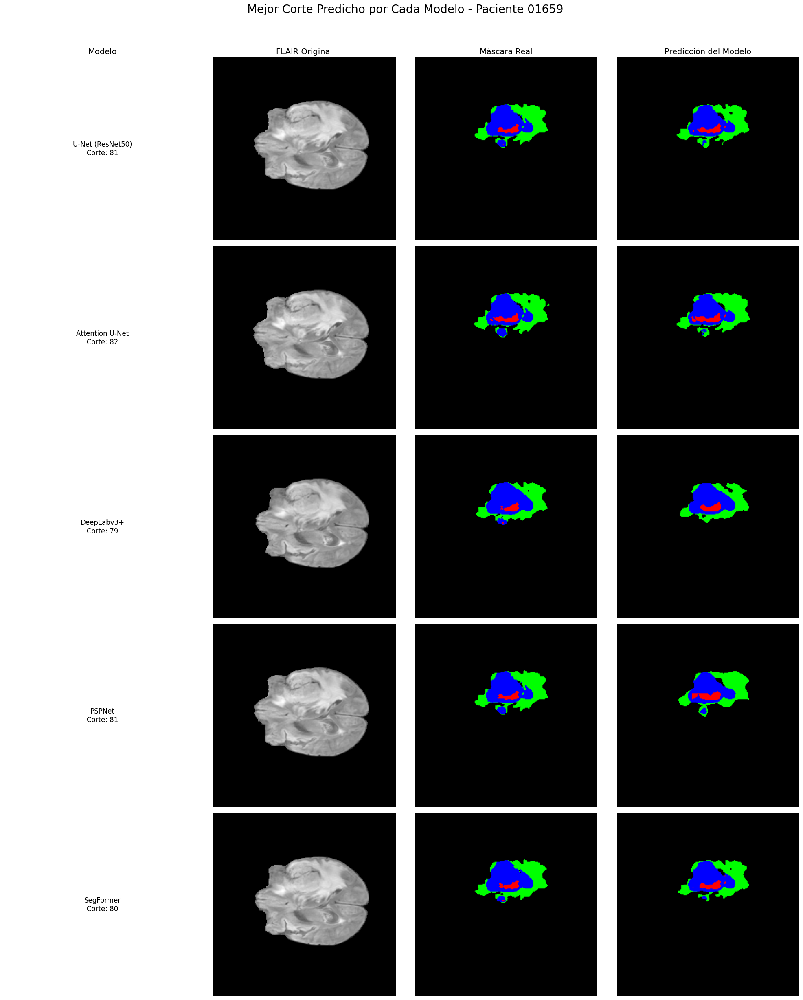

Generando visualización completa: 100%|██████████| 155/155 [00:01<00:00, 100.54it/s]


In [58]:
predict_and_visualize_patient_by_id('01659', models_to_train, DEVICE)


==================== Análisis XAI para el Paciente: 01659 ====================

--- Generando XAI para: U-Net (ResNet50) ---
Mejor corte para U-Net (ResNet50): 81


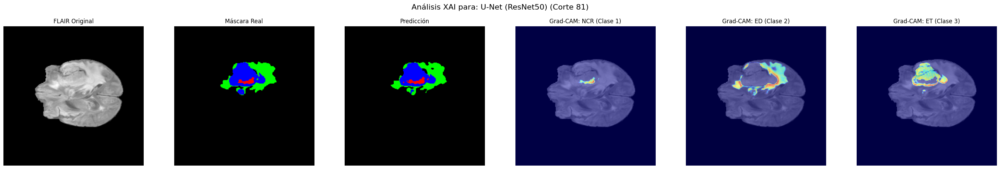


--- Generando XAI para: Attention U-Net ---
Mejor corte para Attention U-Net: 82


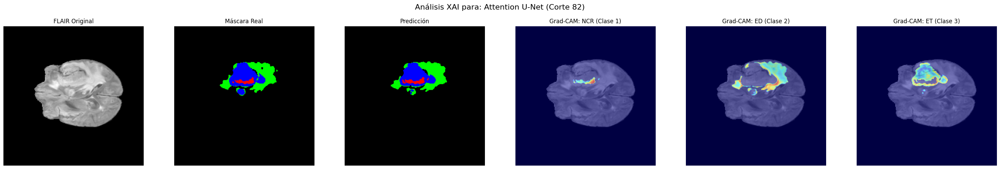


--- Generando XAI para: DeepLabv3+ ---
Mejor corte para DeepLabv3+: 79


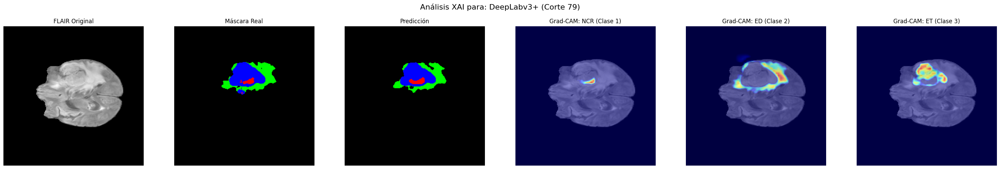


--- Generando XAI para: PSPNet ---
Mejor corte para PSPNet: 81


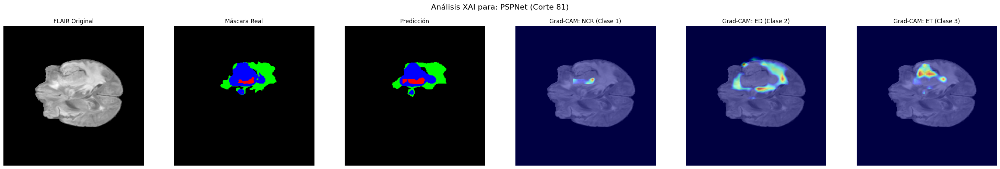


--- Generando XAI para: SegFormer ---
Mejor corte para SegFormer: 80


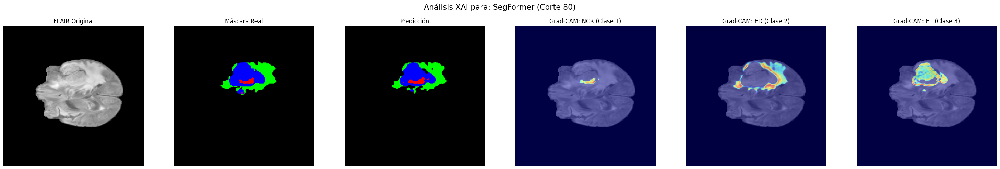

In [60]:
predict_and_visualize_gradcam_by_id('01659', models_to_train, DEVICE)